## Team 2

**Project Title** - Predicting House value based on several house and surrounding attributes

#### Team Members
* Prateek Vachher
* Sunny Parawala
* Windy Zheng

In [21]:
import requests
import folium
import pickle
import re
import string

import numpy as np
import matplotlib.pylab as plt
import seaborn as sns
import pandas as pd

from folium import plugins
from nltk.sentiment.vader import SentimentIntensityAnalyzer

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [22]:
df = pickle.load(open("datafiles/cleandata.ft", "rb"))
df.head()

,totPurchaseAmt,latitude,longitude,bathrooms,bedrooms,livingArea,yearBuilt,averageSchoolRating,zip,description,zestimate
1,198000.0,45.237189,-93.409535,2.0,4.0,1716.0,1996,5.333333,55303,"14649 Iodine Ct NW, Ramsey, MN is a single fam...",285985.0
3,415000.0,45.278217,-93.407533,2.0,3.0,3108.0,1985,6.333333,55303,Stunning walk to Rum River and Creek running t...,431995.0
4,329900.0,45.143781,-93.021604,3.0,4.0,1814.0,2001,6.500000,55038,"2372 Tart Lake Rd, Lino Lakes, MN is a single ...",318162.0
5,262000.0,45.164166,-93.297836,2.0,3.0,2158.0,1985,4.666667,55043,"This large rambler is located on a beautiful, ...",272169.0
6,280000.0,45.283700,-93.332023,2.0,3.0,1993.0,1976,7.333333,55304,You won't want to miss out on this beautiful h...,290365.0


In [23]:
len(df)

28078

### Sentiment Analysis

In [24]:
def remove_mypunct(corpus):

    corpus = map(lambda x: re.sub(r"(#|@|http)\S+", "", x), corpus) #get rid of hashtags 
    corpus = map(lambda x: re.sub(r"(\t|\n|\v|…|“|”)", "", x), corpus) #get rid of whitesape
    corpus = map(lambda x:  re.sub(r"""\w*\d\w*""", ' ', x.lower()), corpus) #get rid of numbers
    punc_re = re.compile('[%s]' % re.escape(string.punctuation))
    corpus = map(lambda x: punc_re.sub(' ', x), corpus)
    corpus = map(lambda x: re.sub('[\W_]+', " ", x), corpus) #get rid of emojis
    
    return list(corpus)

sid = SentimentIntensityAnalyzer()
score_tuples = []
score = []

for i in df.index.values:
    clean_house = remove_mypunct([df.description[i]])
    ss = sid.polarity_scores(clean_house[0])
    df.at[i, 'sentiment'] = float(ss['compound'])

df = df.drop("description", axis=1)

In [25]:
print ("Maximum Sentiment Score:", df["sentiment"].max())
print ("Minimum Sentiment Score:", df["sentiment"].min())
print ("Average Sentiment of Description:", df["sentiment"].mean())

Maximum Sentiment Score: 0.9992
Minimum Sentiment Score: -0.8934
Average Sentiment of Description: 0.5923133342830685


### Correlation Matrix

<AxesSubplot:>

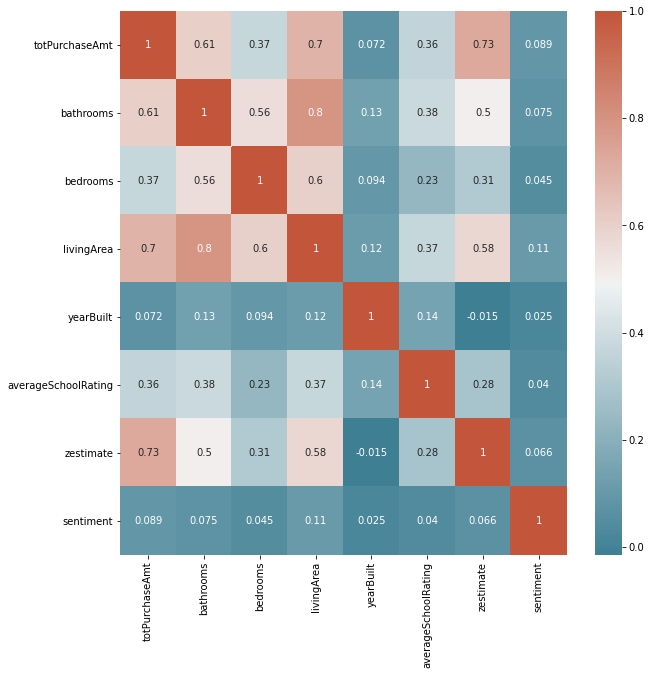

In [26]:
numericalData = df.drop(columns=["zip", "latitude", "longitude"])

corr = numericalData.corr()    # plot the heatmap
plt.subplots(figsize=(10,10))
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, annot=True, 
            cmap=sns.diverging_palette(220, 20, as_cmap=True))

* We see that **totPurchaseAmt and zestimate have a strong positive correlation**. That is expected since the zillow price prediction model is built on the totPurchaseAmt dataset

* We see that the **price of a house is positively correlated to the living area and the number of bathrooms**.

* We also see an interesting trend of the **average school rating being better near recently built houses**.

* As expected we see that an **increase in number of bedrooms in a house also increases the number of bathrooms**.

### ScatterPlots

<AxesSubplot:xlabel='averageSchoolRating', ylabel='totPurchaseAmt'>

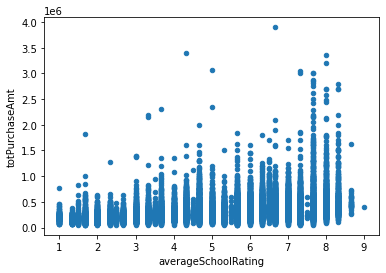

In [27]:
df.plot(kind='scatter', x='averageSchoolRating', y='totPurchaseAmt')

<AxesSubplot:xlabel='livingArea', ylabel='totPurchaseAmt'>

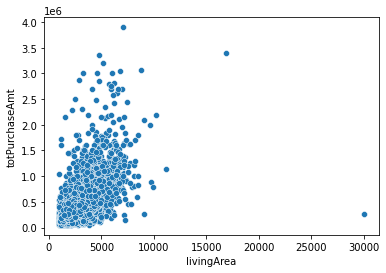

In [28]:
sns.scatterplot(x='livingArea', y='totPurchaseAmt', data=df)

<AxesSubplot:xlabel='bedrooms', ylabel='bathrooms'>

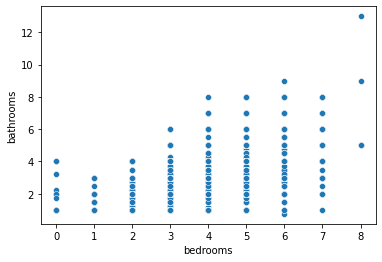

In [29]:
sns.scatterplot(x='bedrooms', y='bathrooms', data=df)

<AxesSubplot:xlabel='livingArea', ylabel='bedrooms'>

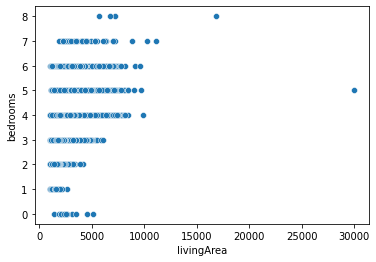

In [30]:
sns.scatterplot(x='livingArea', y='bedrooms', data=df)

### Regional Listing HeatMap

In [31]:
numListings = df.groupby('zip').count()

numListingsByZip = pd.DataFrame()

numListingsByZip["zip"] = [str(i) for i in numListings.index]
numListingsByZip["numListings"] = numListings["totPurchaseAmt"].values

In [32]:
jsonData = requests.get("https://raw.githubusercontent.com/OpenDataDE/State-zip-code-GeoJSON/master/mn_minnesota_zip_codes_geo.min.json")
mnArea = jsonData.json()

In [33]:
mnMap = folium.Map(location=[44.9778, -93.2650], tiles="Stamen Toner", zoom_start=8)

mnMap.choropleth(geo_data=mnArea, data=numListingsByZip, columns=["zip", "numListings"], 
                 key_on='feature.properties.ZCTA5CE10', fill_color='YlGn', fill_opacity=1)
mnMap

### Deviation in Z-Estimate and Actual Price Listing

In [34]:
len(df[df["totPurchaseAmt"] > df["zestimate"]])

706

In [35]:
len(df[df["totPurchaseAmt"] == df["zestimate"]])

1

In [36]:
len(df[df["totPurchaseAmt"] < df["zestimate"]])

27371

In [37]:
difference = abs(df["totPurchaseAmt"] - df["zestimate"])
difference.mean()

48800.88453878481

We see that in majority of the cases, the zillow price estimatation model **over-estimated the price** of the house compared to how much it was actually bought for. Zillow has a **MAE of $48,800** for the clean filtered dataset we use for this project.

In [39]:
pickle.dump(df, open("datafiles/after-EDA.ft", "wb"))